In [2]:
#Basic Operations
import pandas as pd
import numpy as np

#visualizing libraries
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import seaborn as sns
from sklearn.feature_selection import mutual_info_classif
import streamlit as st

#data preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

#Model
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score, roc_curve, auc



**1.Data Loading**

In [3]:
df = pd.read_csv("EEG_EYE_DATASET.csv")
df.head()

,id,AF3,F7,F3,FC5,T7,P,O1,O2,P8,T8,FC6,F4,F8,AF4,Class
0,1,4329.23,4009.23,4289.23,4148.21,4350.26,4586.15,4096.92,4641.03,4222.05,4238.46,4211.28,4280.51,4635.90,4393.85,1
1,2,4324.62,4004.62,4293.85,4148.72,4342.05,4586.67,4097.44,4638.97,4210.77,4226.67,4207.69,4279.49,4632.82,4384.10,1
2,3,4327.69,4006.67,4295.38,4156.41,4336.92,4583.59,4096.92,4630.26,4207.69,4222.05,4206.67,4282.05,4628.72,4389.23,1
3,4,4328.72,4011.79,4296.41,4155.90,4343.59,4582.56,4097.44,4630.77,4217.44,4235.38,4210.77,4287.69,4632.31,4396.41,1
4,5,4326.15,4011.79,4292.31,4151.28,4347.69,4586.67,4095.90,4627.69,4210.77,4244.10,4212.82,4288.21,4632.82,4398.46,1


**2.Data Preparation**

In [4]:
# Shape and info
print("Shape:", df.shape)
df.info()

Shape: (14980, 16)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14980 entries, 0 to 14979
Data columns (total 16 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      14980 non-null  int64  
 1   AF3     14980 non-null  float64
 2   F7      14980 non-null  float64
 3   F3      14980 non-null  float64
 4   FC5     14980 non-null  float64
 5   T7      14980 non-null  float64
 6   P       14980 non-null  float64
 7   O1      14980 non-null  float64
 8   O2      14980 non-null  float64
 9   P8      14980 non-null  float64
 10  T8      14980 non-null  float64
 11  FC6     14980 non-null  float64
 12  F4      14980 non-null  float64
 13  F8      14980 non-null  float64
 14  AF4     14980 non-null  float64
 15  Class   14980 non-null  int64  
dtypes: float64(14), int64(2)
memory usage: 1.8 MB


**3.Checking the summary statistics**

In [5]:
# Summary statistics
df.describe()

,id,AF3,F7,F3,FC5,T7,P,O1,O2,P8,T8,FC6,F4,F8,AF4,Class
count,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000,14980.000000
mean,7490.500000,4321.917777,4009.767694,4264.022433,4164.946326,4341.741075,4644.022379,4110.400160,4616.056904,4218.826610,4231.316200,4202.456900,4279.232774,4615.205336,4416.435832,1.448798
std,4324.497851,2492.072174,45.941672,44.428052,5216.404632,34.738821,2924.789537,4600.926543,29.292603,2136.408523,38.050903,37.785981,41.544312,1208.369958,5891.285043,0.497388
min,1.000000,1030.770000,2830.770000,1040.000000,2453.330000,2089.740000,2768.210000,2086.150000,4567.180000,1357.950000,1816.410000,3273.330000,2257.950000,86.666700,1366.150000,1.000000
25%,3745.750000,4280.510000,3990.770000,4250.260000,4108.210000,4331.790000,4611.790000,4057.950000,4604.620000,4190.770000,4220.510000,4190.260000,4267.690000,4590.770000,4342.050000,1.000000
50%,7490.500000,4294.360000,4005.640000,4262.560000,4120.510000,4338.970000,4617.950000,4070.260000,4613.330000,4199.490000,4229.230000,4200.510000,4276.920000,4603.080000,4354.870000,1.000000
75%,11235.250000,4311.790000,4023.080000,4270.770000,4132.310000,4347.180000,4626.670000,4083.590000,4624.100000,4209.230000,4239.490000,4211.280000,4287.180000,4617.440000,4372.820000,2.000000
max,14980.000000,309231.000000,7804.620000,6880.510000,642564.000000,6474.360000,362564.000000,567179.000000,7264.100000,265641.000000,6674.360000,6823.080000,7002.560000,152308.000000,715897.000000,2.000000


In [6]:
# Check for missing values
df.isnull().sum()

id       0
AF3      0
F7       0
F3       0
FC5      0
T7       0
P        0
O1       0
O2       0
P8       0
T8       0
FC6      0
F4       0
F8       0
AF4      0
Class    0
dtype: int64

**4. Check for Duplicates**

In [7]:
# Check and drop duplicates
df.duplicated().sum()
df.drop_duplicates(inplace=True)

In [8]:
# Encode Categorical Variables (if any)

In [9]:
df = pd.get_dummies(df, drop_first=True)

**5. Normalize / Scale Features**

In [10]:
# Assuming last column is the target
features = df.iloc[:, :-1]
target = df.iloc[:, -1]

scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

# Convert back to DataFrame if needed
scaled_df = pd.DataFrame(scaled_features, columns=features.columns)
scaled_df['Target'] = target.values


**6.Visualization**

In [11]:
#6.1. Target based distribution {Stack}

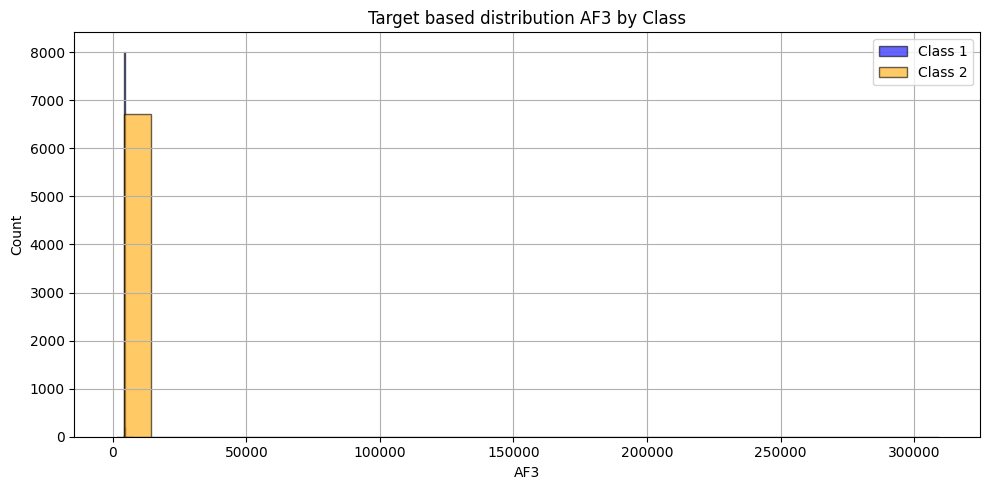

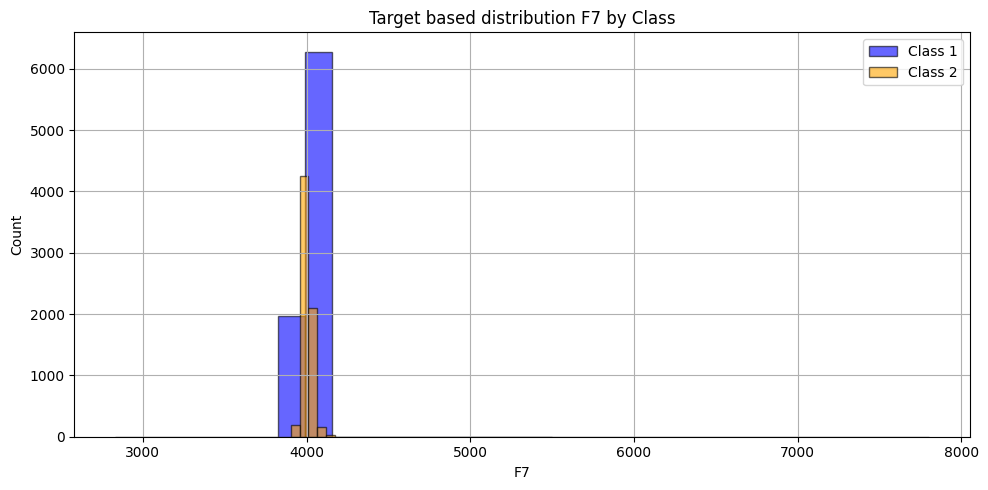

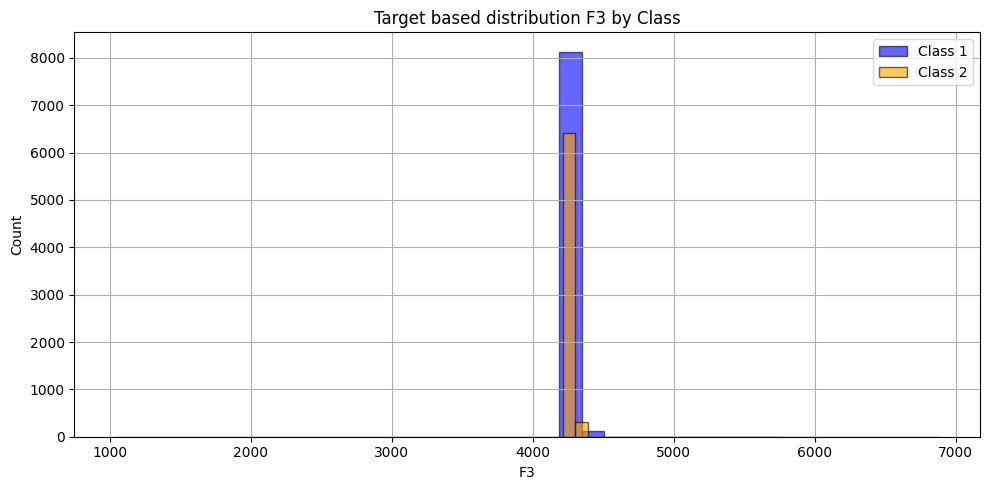

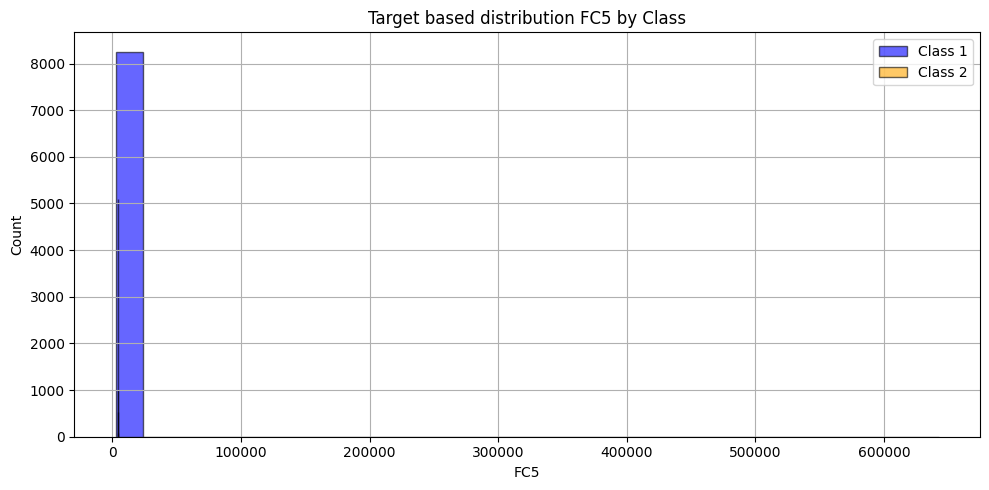

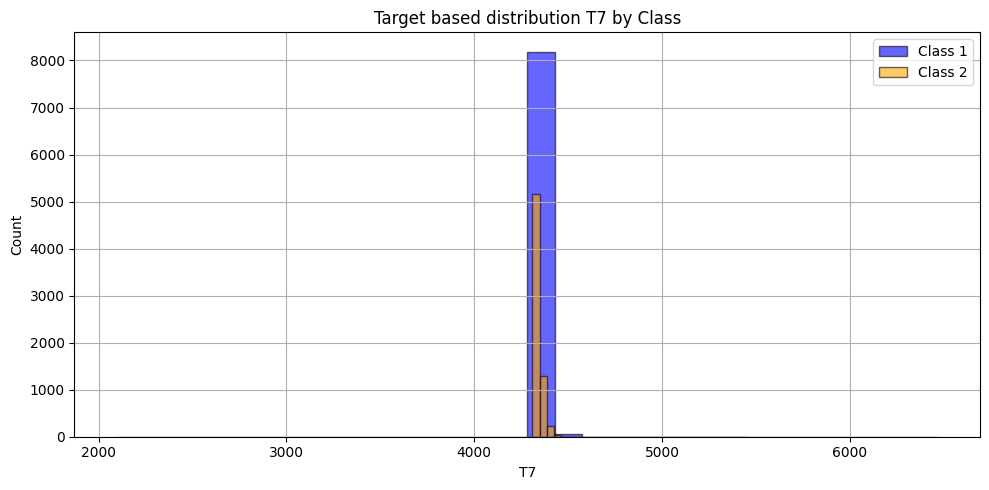

...

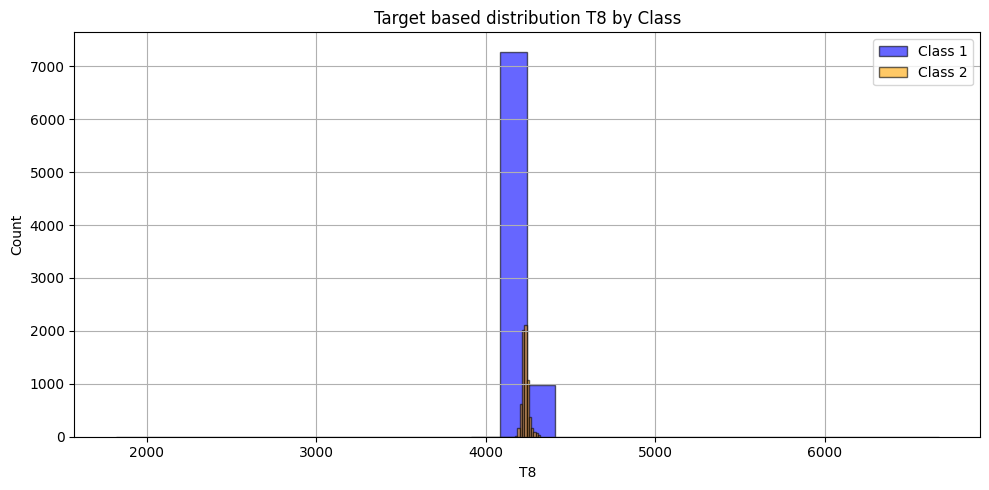

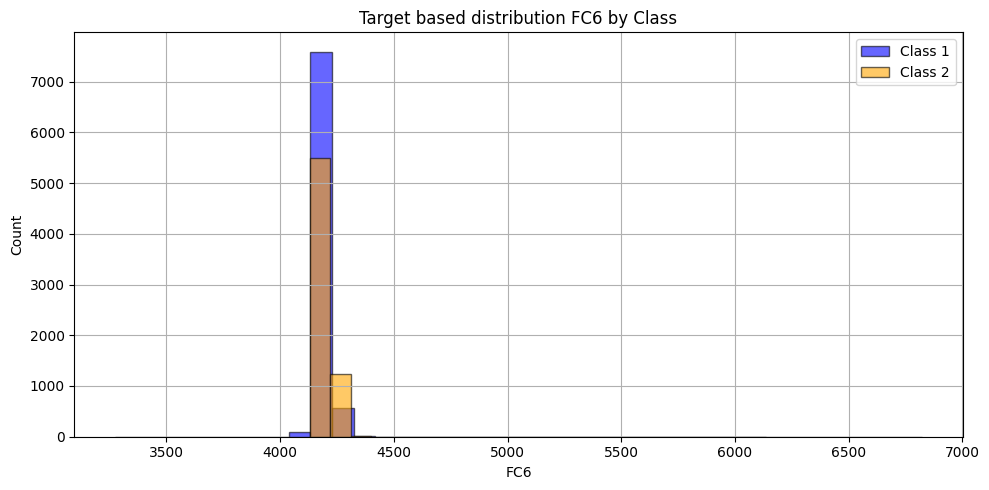

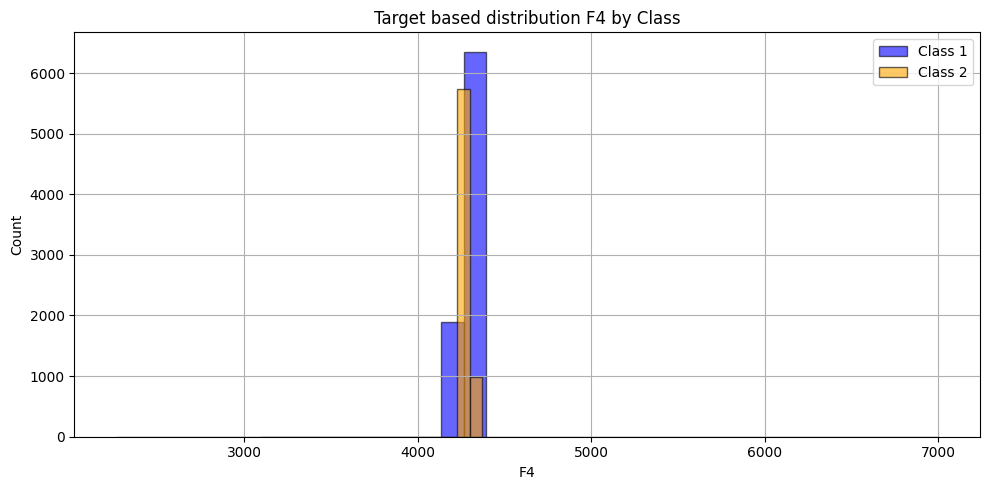

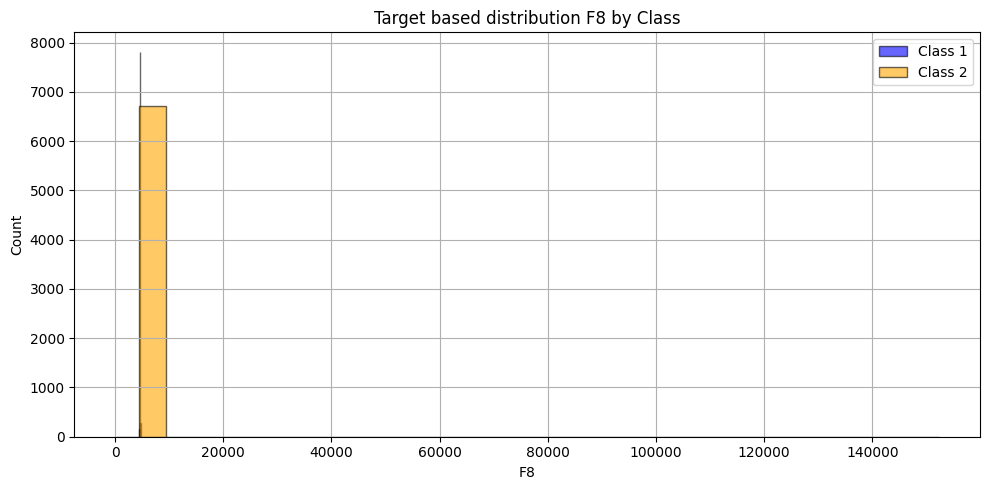

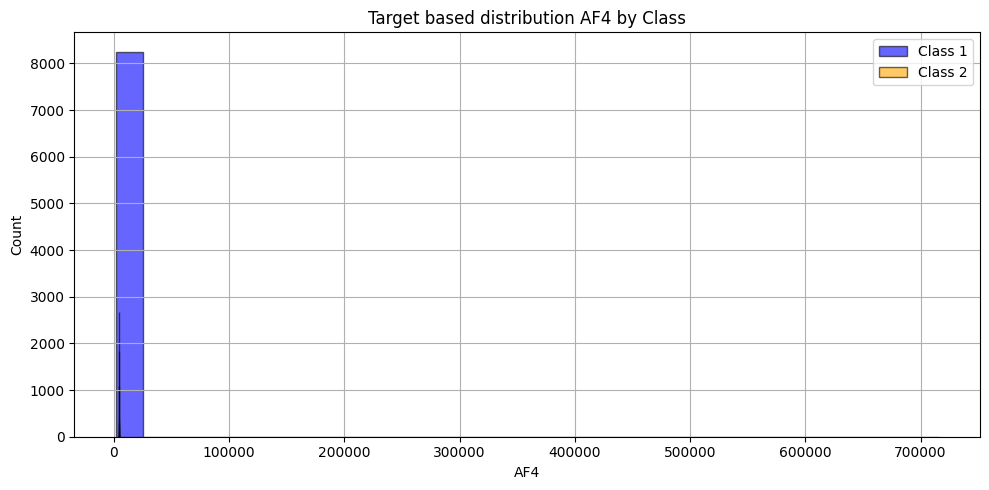

In [12]:

# Load and filter dataset
df = pd.read_csv("EEG_EYE_DATASET.csv")
df = df[df['Class'].isin([1, 2])].drop(columns=['id'], errors='ignore')

# Separate numeric columns
numeric_cols = [col for col in df.columns if col != 'Class' and df[col].dtype in ['float64', 'int64']]

# ---------- Histograms using Matplotlib ----------
for col in numeric_cols:
    data_class1 = df[df['Class'] == 1][col].dropna()
    data_class2 = df[df['Class'] == 2][col].dropna()

    plt.figure(figsize=(10, 5))
    plt.hist(data_class1, bins=30, alpha=0.6, label='Class 1', color='blue', edgecolor='black', density=False)
    plt.hist(data_class2, bins=30, alpha=0.6, label='Class 2', color='orange', edgecolor='black', density=False)

    plt.title(f'Target based distribution {col} by Class')
    plt.xlabel(col)
    plt.ylabel('Count')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [13]:
#6.2. Individual distribution 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


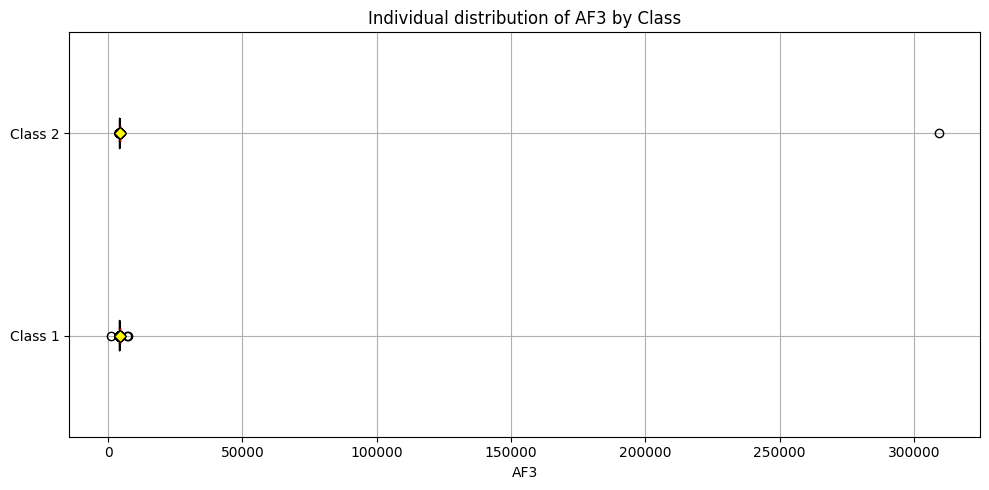

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


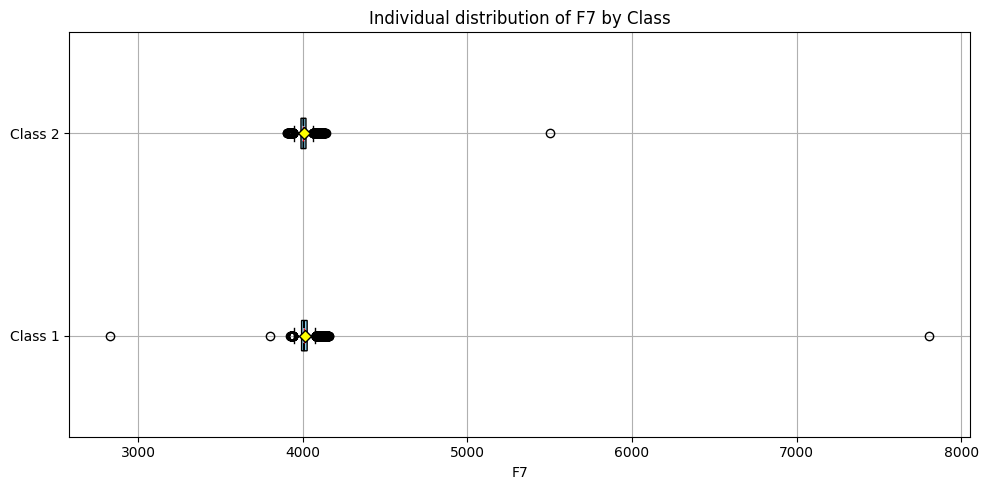

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


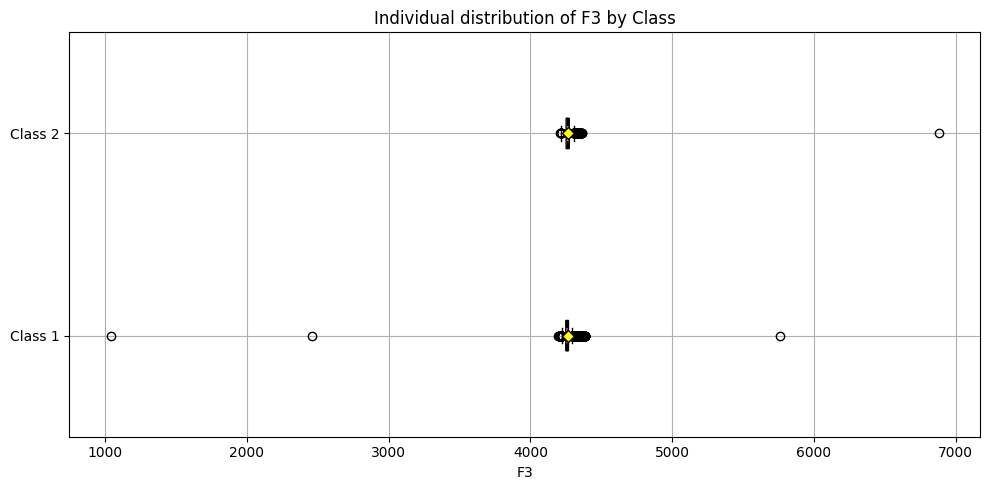

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


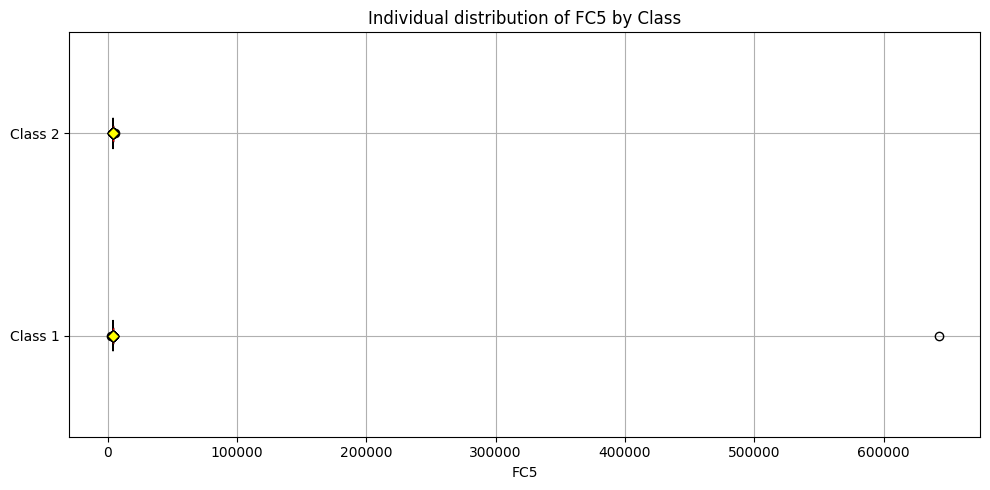

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


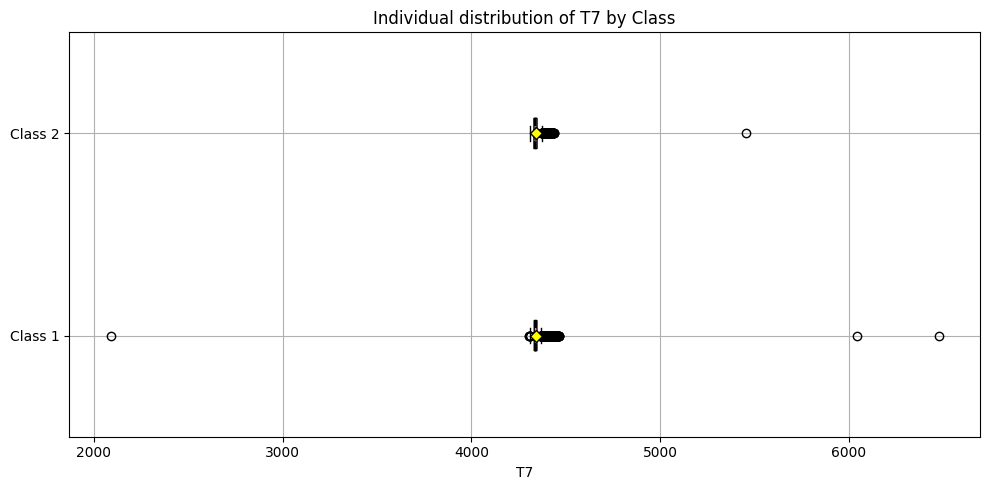

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


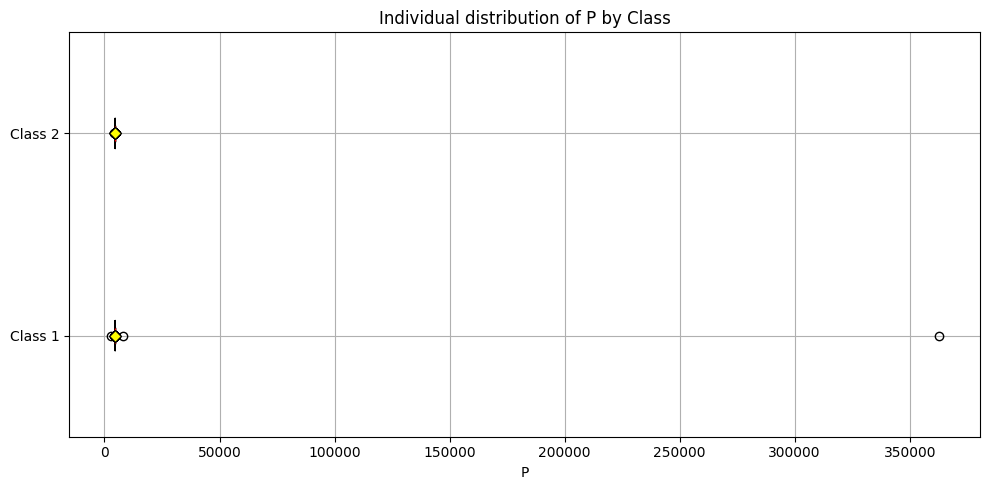

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


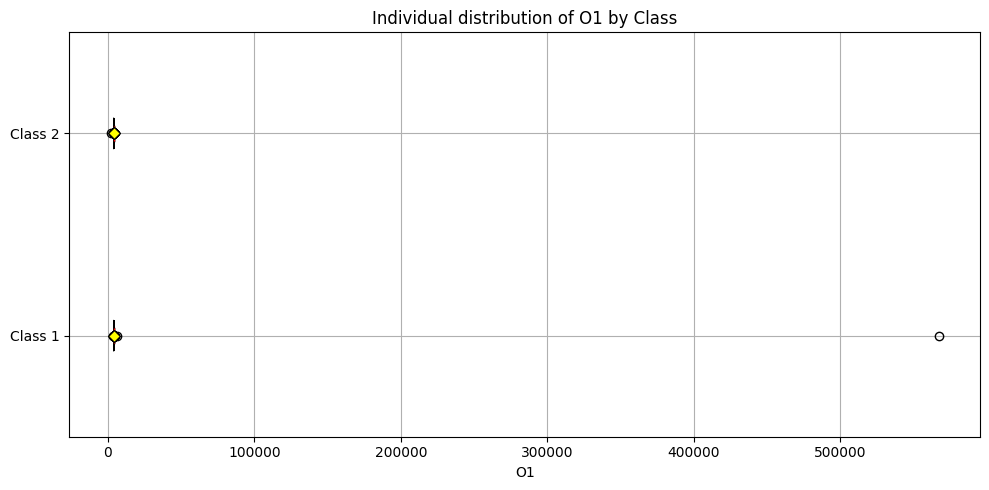

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


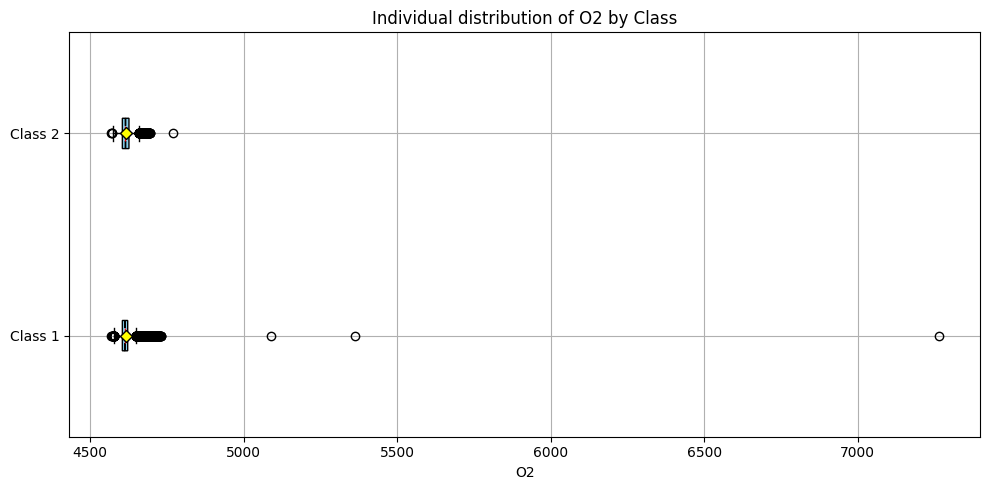

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


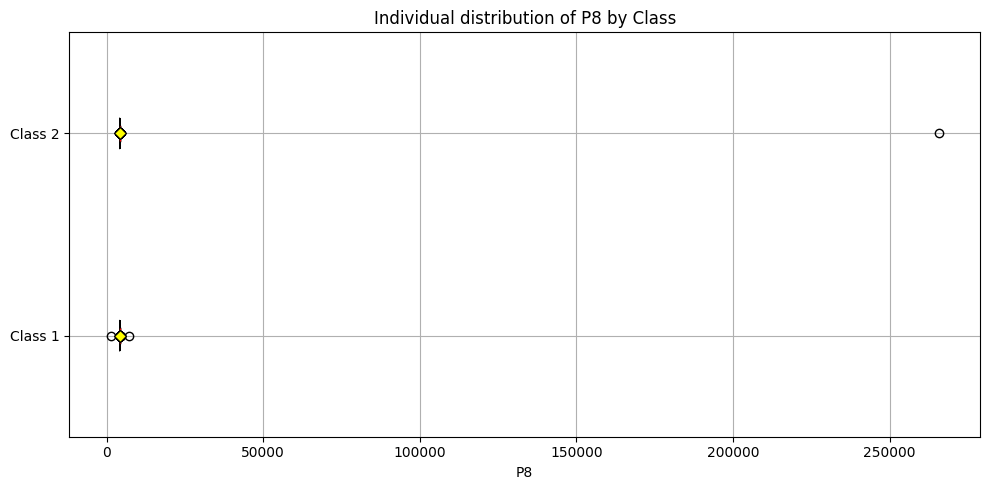

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


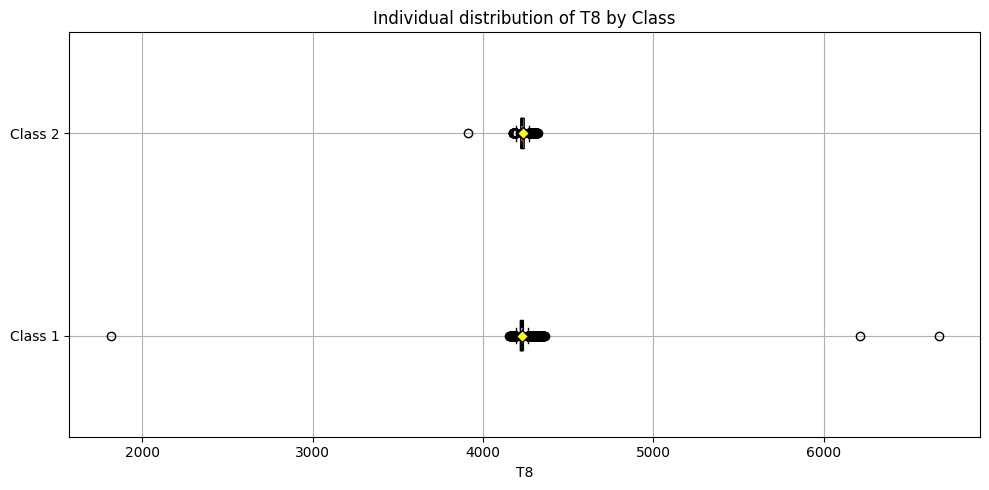

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


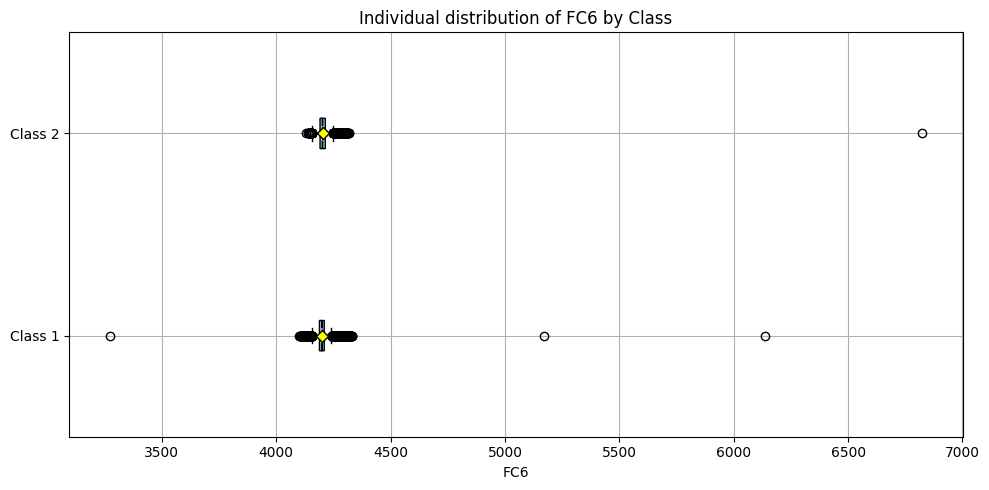

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


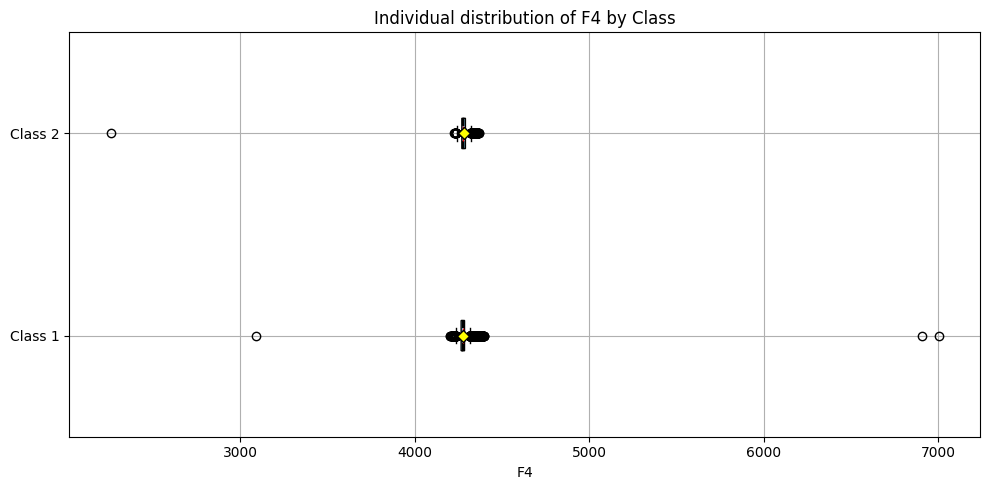

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


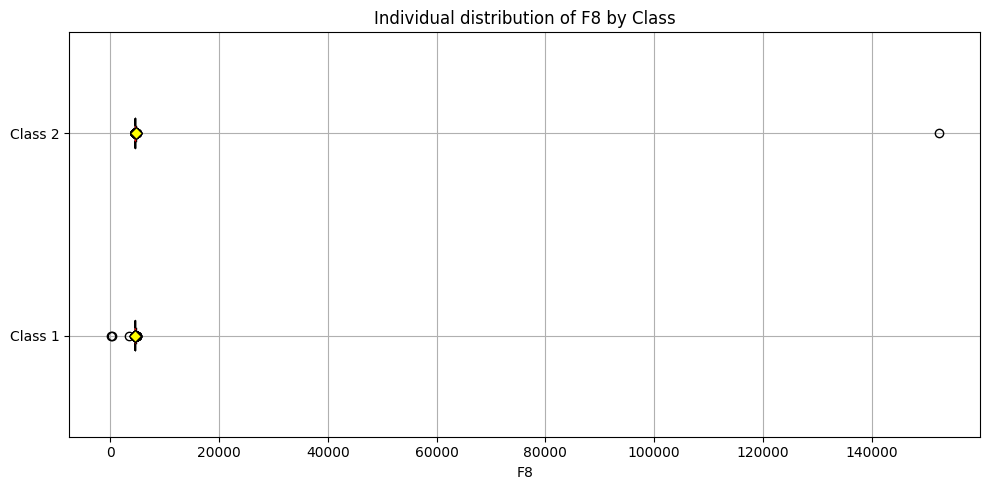

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2024017160.py:14: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


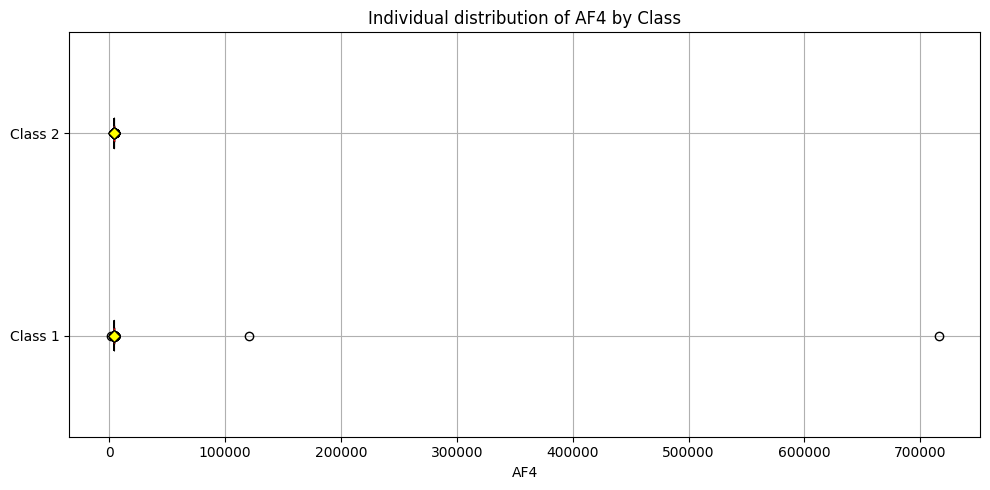

In [14]:

# Load and filter dataset
df = pd.read_csv("EEG_EYE_DATASET.csv")
df = df[df['Class'].isin([1, 2])].drop(columns=['id'], errors='ignore')

# Separate numeric columns
numeric_cols = [col for col in df.columns if col != 'Class' and df[col].dtype in ['float64', 'int64']]

# ---------- Boxplots using Matplotlib ----------
for col in numeric_cols:
    data_class1 = df[df['Class'] == 1][col].dropna()
    data_class2 = df[df['Class'] == 2][col].dropna()
    
    plt.figure(figsize=(10, 5))
    plt.boxplot(
        [data_class1, data_class2],
        patch_artist=True,
        notch=True,
        vert=False,
        showmeans=True,
        labels=['Class 1', 'Class 2'],
        boxprops=dict(facecolor='skyblue'),
        medianprops=dict(color='red'),
        meanprops=dict(marker='D', markeredgecolor='black', markerfacecolor='yellow')
    )
    plt.title(f'Individual distribution of {col} by Class')
    plt.xlabel(col)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [15]:
#6.3. Scatter plot with comparison of each electrode results depending on the Class 1 and 2

In [16]:

# Load and filter dataset
df = pd.read_csv("EEG_EYE_DATASET.csv")
df = df[df['Class'].isin([1, 2])].drop(columns=['id'], errors='ignore')

# Select numeric columns excluding 'Class'
cols = [col for col in df.columns if col != 'Class' and df[col].dtype in ['float64', 'int64']]

# Set default x and y columns
x_default = cols[0]
y_default = cols[1]

# Create a color mapping for Class 1 and 2
color_map = {1: 'blue', 2: 'orange'}
colors = df['Class'].map(color_map)

# Create initial scatter plot
fig = go.Figure()

scatter = go.Scatter(
    x=df[x_default],
    y=df[y_default],
    mode='markers',
    marker=dict(color=colors),
    name=f'{x_default} vs {y_default}',
    showlegend=False
)

fig.add_trace(scatter)

# Dropdown menus for X and Y axis selection
x_buttons = [
    dict(label=col,
         method='restyle',
         args=[{'x': [df[col]]},
               [0]])
    for col in cols
]

y_buttons = [
    dict(label=col,
         method='restyle',
         args=[{'y': [df[col]]},
               [0]])
    for col in cols
]

# Add dropdowns to layout
fig.update_layout(
    updatemenus=[
        dict(
            buttons=x_buttons,
            direction='down',
            showactive=True,
            x=0.1,
            xanchor='left',
            y=1.15,
            yanchor='top',
            pad={'r': 10, 't': 10},
        ),
        dict(
            buttons=y_buttons,
            direction='down',
            showactive=True,
            x=0.4,
            xanchor='left',
            y=1.15,
            yanchor='top',
            pad={'r': 10, 't': 10},
        )
    ],
    title=f'Scatter Plot: {x_default} vs {y_default} (Class 1 & 2)',
    height=600
)

fig.update_xaxes(title=x_default)
fig.update_yaxes(title=y_default)

# Add legend manually
fig.add_trace(go.Scatter(
    x=[None],
    y=[None],
    mode='markers',
    marker=dict(size=10, color='blue'),
    name='Class 1'
))

fig.add_trace(go.Scatter(
    x=[None],
    y=[None],
    mode='markers',
    marker=dict(size=10, color='orange'),
    name='Class 2'
))

fig.show()


In [17]:
# 6.4. Top four numeric feature interactions and Top four feature interactions {seaborn pairplot}

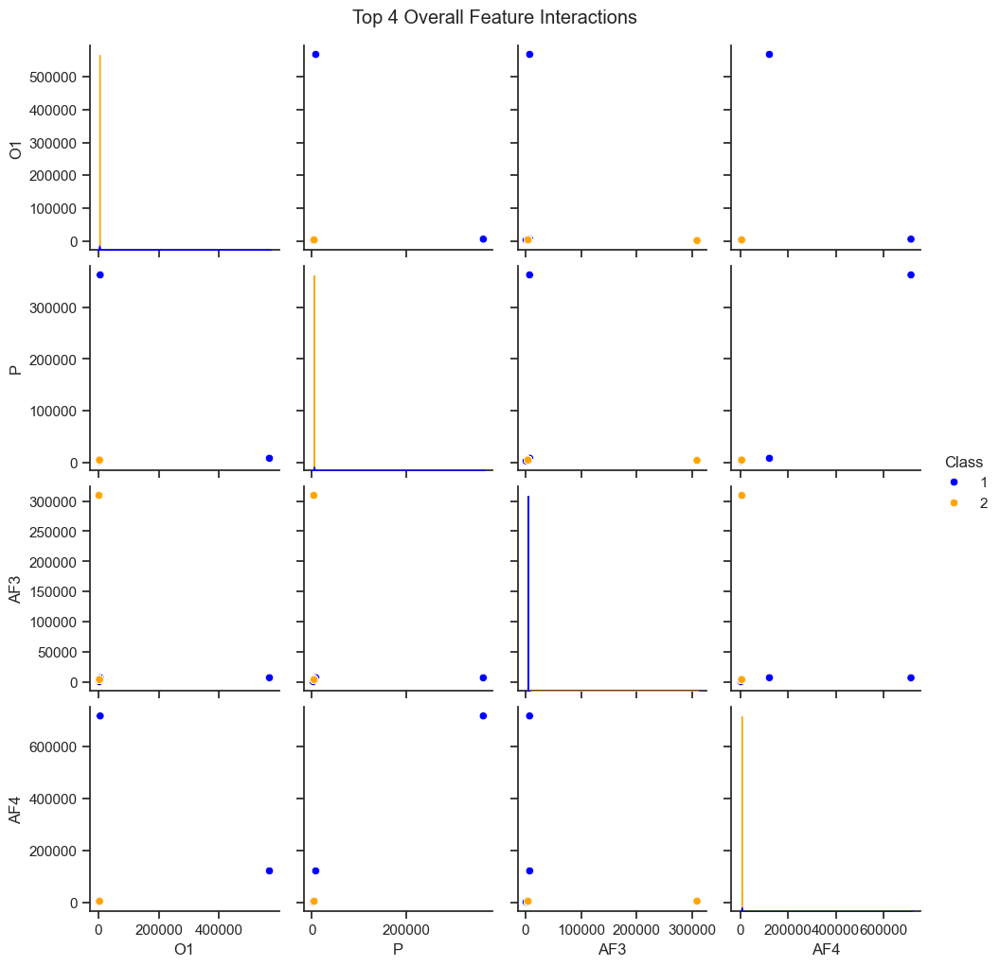

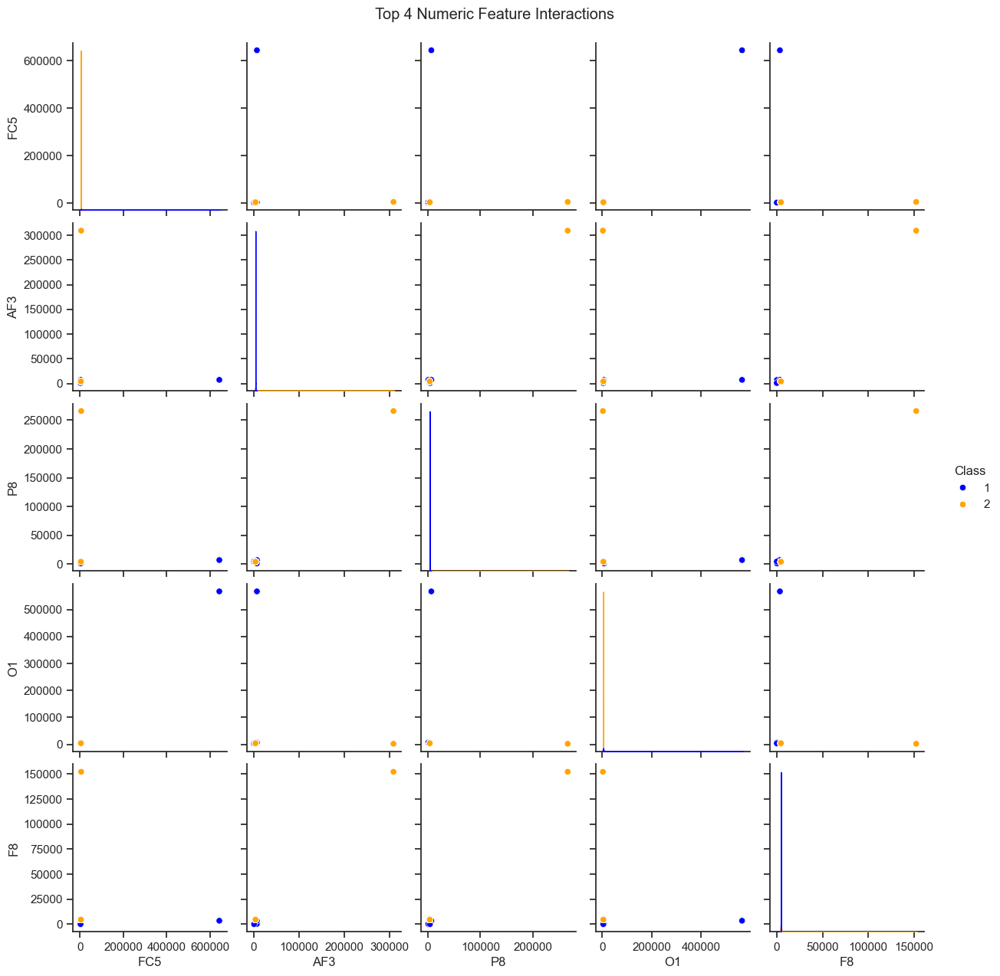

In [18]:


# Load and filter dataset
df = pd.read_csv("EEG_EYE_DATASET.csv")
df = df[df['Class'].isin([1, 2])].drop(columns=['id'], errors='ignore')

# Separate types
numeric_cols = [col for col in df.columns if col != 'Class' and df[col].dtype in ['float64', 'int64']]
nominal_cols = [col for col in df.columns if col != 'Class' and df[col].dtype == 'object']

# ---------- 1. Top 4 Overall Feature Interactions (Based on Mutual Information)
X_all = df[numeric_cols]
y = df['Class']
mi_scores = mutual_info_classif(X_all, y)
mi_series = pd.Series(mi_scores, index=numeric_cols).sort_values(ascending=False)

top4_overall = mi_series.head(4).index.tolist()

# ---------- 2. Top 4 Numeric Interactions (Based on correlation)
cor_matrix = df[numeric_cols].corr().abs()

# Remove self-correlations by setting diagonal to 0
np.fill_diagonal(cor_matrix.values, 0)

# Flatten and get top 4 pairs
corr_pairs = (
    cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))
    .stack()
    .sort_values(ascending=False)
    .head(4)
)

top_numeric_features = list(set(corr_pairs.index.get_level_values(0).tolist() + 
                                corr_pairs.index.get_level_values(1).tolist()))

# ---------- 3. Top 4 Nominal Interactions (Optional - fallback if no nominal columns)
if nominal_cols:
    nominal_df = df[nominal_cols + ['Class']]
    # Dummy encode nominal columns
    encoded = pd.get_dummies(nominal_df.drop(columns='Class'), drop_first=True)
    mi_nominal = mutual_info_classif(encoded, y)
    mi_nom_series = pd.Series(mi_nominal, index=encoded.columns).sort_values(ascending=False)
    top_nominal_features = mi_nom_series.head(4).index.tolist()
else:
    top_nominal_features = []

# ---------- Plotting using Seaborn
sns.set(style="ticks")

# 1. Top Overall
if top4_overall:
    sns.pairplot(df[top4_overall + ['Class']], hue='Class', palette={1: 'blue', 2: 'orange'})
    plt.suptitle("Top 4 Overall Feature Interactions", y=1.02)
    plt.show()

# 2. Top Numeric
if top_numeric_features:
    sns.pairplot(df[top_numeric_features + ['Class']], hue='Class', palette={1: 'blue', 2: 'orange'})
    plt.suptitle("Top 4 Numeric Feature Interactions", y=1.02)
    plt.show()

# 3. Top Nominal
if top_nominal_features:
    nom_df_plot = df.copy()
    # Rebuild from original column names (before one-hot encoding)
    nom_df_plot = nom_df_plot[[col.split('_')[0] for col in top_nominal_features] + ['Class']]
    sns.pairplot(nom_df_plot, hue='Class', palette={1: 'blue', 2: 'orange'})
    plt.suptitle("Top 4 Nominal Feature Interactions", y=1.02)
    plt.show()


**Separate features and target**

In [20]:
# Load the EEG dataset
df = pd.read_csv("EEG_EYE_DATASET.csv")  # Or load from your actual uploaded file if it's different
df = df[df['Class'].isin([1, 2])].drop(columns=['id'], errors='ignore')

# Separate features and target
X = df.drop(columns=['Class'])
y = df['Class']


**Standardization**

In [21]:

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)


**Split train-test data**

In [22]:
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)


**Building Machine Learning ALgorithms**

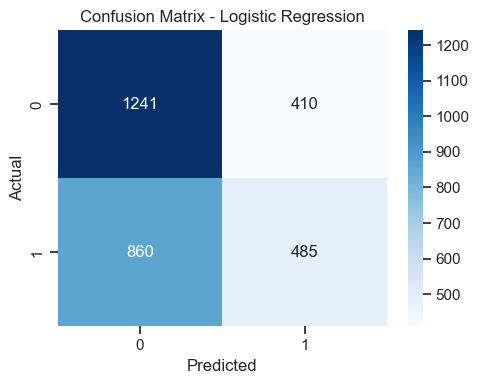

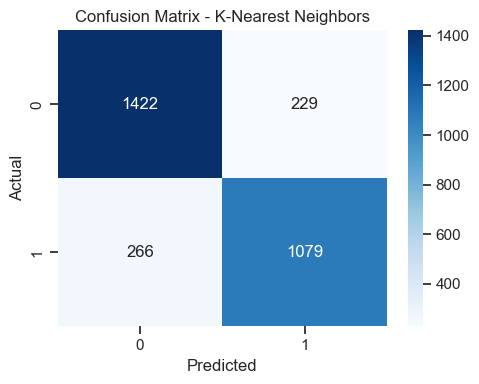

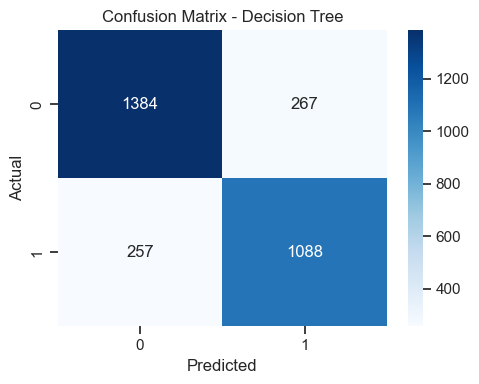

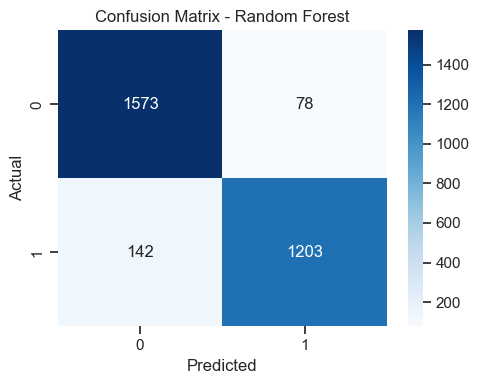

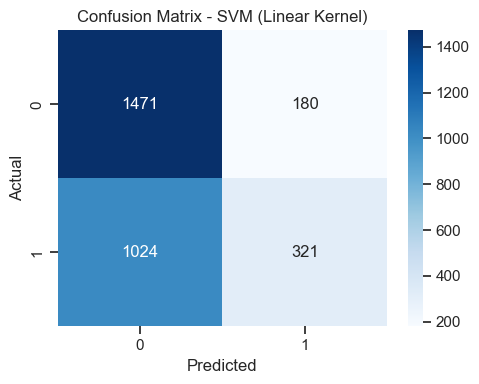

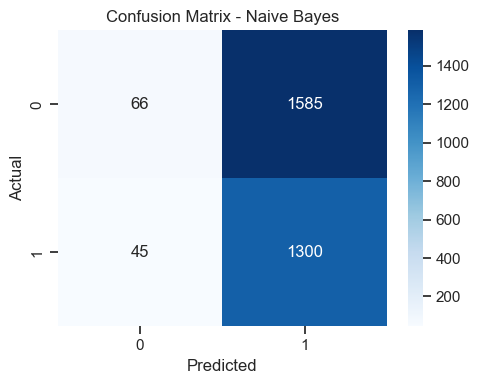

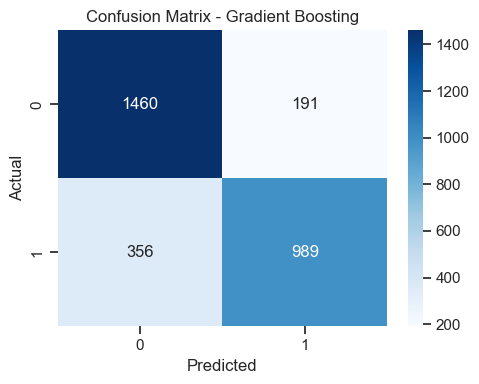

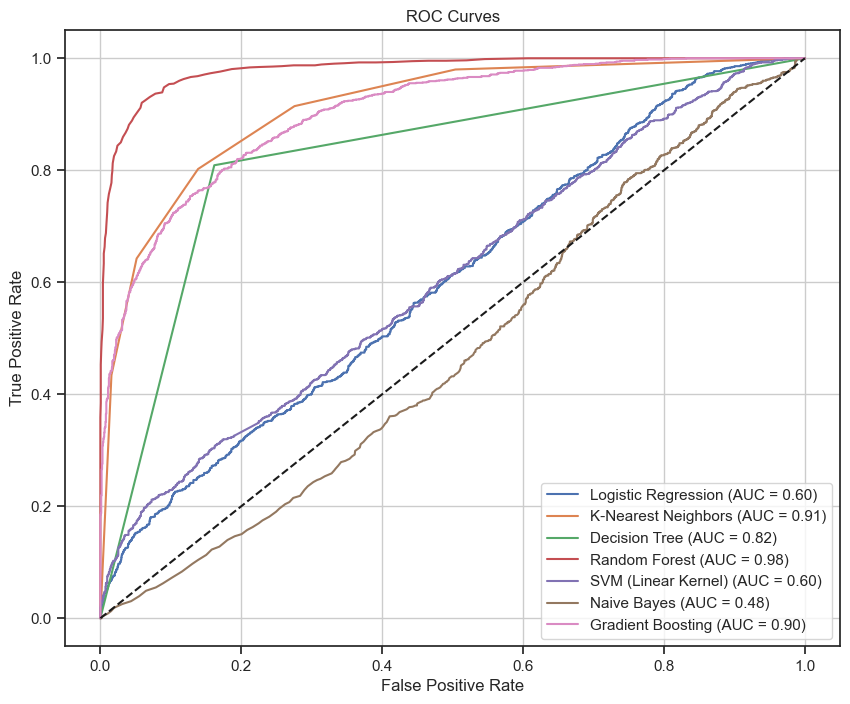

C:\Users\Administrator\AppData\Local\Temp\ipykernel_3328\2359643624.py:74: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




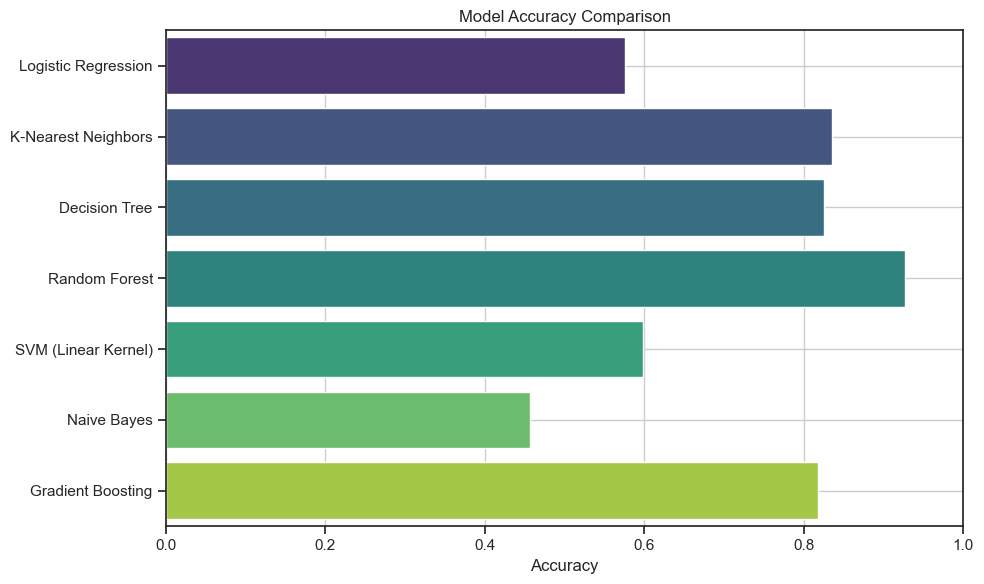


✅ Best Performing Model: Random Forest with Accuracy = 0.9266


In [26]:
# Load the EEG dataset
df = pd.read_csv("EEG_EYE_DATASET.csv")
df = df[df['Class'].isin([1, 2])].drop(columns=['id'], errors='ignore')

# Separate features and target
X = df.drop(columns=['Class'])
y = df['Class']

# Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Change class labels from {1, 2} to {0, 1}
y = y - 1

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y, test_size=0.2, random_state=42, stratify=y
)
# Initialize models
models = {
    "Logistic Regression": LogisticRegression(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "SVM (Linear Kernel)": SVC(kernel='linear', probability=True),
    "Naive Bayes": GaussianNB(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Store results
accuracy_results = {}
roc_auc_results = {}

# Train and evaluate each model
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]  # <-- Corrected here

    acc = accuracy_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_prob)

    accuracy_results[name] = acc
    roc_auc_results[name] = roc_auc

    # Plot confusion matrix
    plt.figure(figsize=(5, 4))
    cm = confusion_matrix(y_test, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix - {name}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.tight_layout()
    plt.show()

# Plot ROC Curves
plt.figure(figsize=(10, 8))
for name, model in models.items():
    y_prob = model.predict_proba(X_test)[:, 1]  # <-- Corrected here
    fpr, tpr, _ = roc_curve(y_test, y_prob, pos_label=1)  # Pass pos_label=1
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc_results[name]:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.title('ROC Curves')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid()
plt.show()

# Plot Model Accuracies
plt.figure(figsize=(10, 6))
sns.barplot(x=list(accuracy_results.values()), y=list(accuracy_results.keys()), palette="viridis")
plt.xlabel('Accuracy')
plt.title('Model Accuracy Comparison')
plt.xlim(0, 1)
plt.grid(True)
plt.tight_layout()
plt.show()

# ---------- PRINT the Best Algorithm ----------
best_model = max(accuracy_results, key=accuracy_results.get)
best_accuracy = accuracy_results[best_model]

print(f"\n✅ Best Performing Model: {best_model} with Accuracy = {best_accuracy:.4f}")


**# ---------- PRINT the Best Algorithm ----------**

In [27]:
best_model = max(accuracy_results, key=accuracy_results.get)
best_accuracy = accuracy_results[best_model]

print(f"\n✅ Best Performing Model: {best_model} with Accuracy = {best_accuracy:.4f}")


✅ Best Performing Model: Random Forest with Accuracy = 0.9266
